In [ ]:
!mkdir images

In [ ]:
import tensorflow as tf
from keras import layers
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

In [ ]:
_img = np.load("ai_gen_faces.npy")
_img = (_img - 127.5) / 127.5

<ipython-input-20-d3d46399cfee>:5: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(sqr,sqr,i+1)


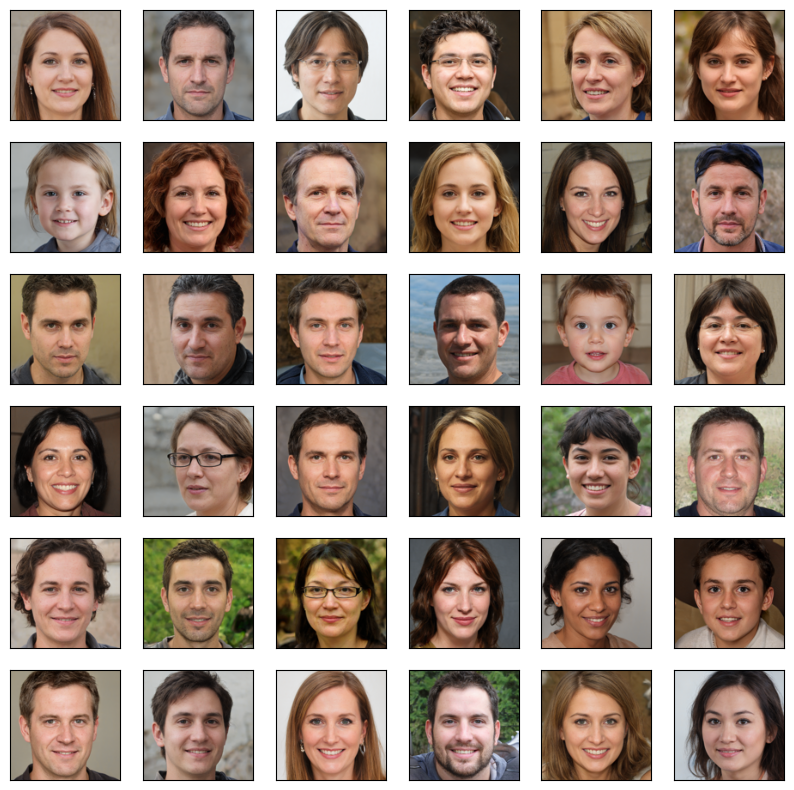

In [ ]:
def plot_images(sqr = 5):
    plt.figure(figsize = (10,10))
    plt.title("Real Images",fontsize = 35)
    for i in range(sqr * sqr):
        plt.subplot(sqr,sqr,i+1)
        plt.imshow(_img[i]*0.5 + 0.5 )
        plt.xticks([])
        plt.yticks([])

# to plot images
plot_images(6)


In [ ]:
batch_size = 32
dataset=tf.data.Dataset.from_tensor_slices(np.array(_img)).batch(batch_size)

In [ ]:
latent_dim = 100
def Generator():
    model = tf.keras.Sequential()
    model.add(layers.Dense(128*128*3, use_bias=False, input_shape=(latent_dim,)))
    model.add(layers.Reshape((128,128,3)))
    model.add(tf.keras.layers.Conv2D(128,4, strides=1, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.Conv2D(128,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2D(256,4, strides=1, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.Conv2D(256,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2DTranspose(512, 4, strides=1,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.Conv2D(512,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2DTranspose(512, 4, strides=1,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.Conv2DTranspose(512, 4, strides=2,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2DTranspose(256, 4, strides=1,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.Conv2DTranspose(256, 4, strides=2,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())

    model.add(tf.keras.layers.Conv2DTranspose(128, 4, strides=2,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.Conv2DTranspose(128, 4, strides=1,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Conv2DTranspose(3,4,strides = 1, padding = 'same',activation = 'tanh'))



    return model

In [ ]:
def Discriminator():
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Input((128, 128, 3)))
    model.add(tf.keras.layers.Conv2D(128,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2D(128,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2D(256,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2D(256,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2D(512,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1,activation = 'sigmoid'))
    return model



In [ ]:
discriminator = Discriminator()
discriminator.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_15 (Conv2D)          (None, 64, 64, 128)       6144      
                                                                 
 batch_normalization_14 (Ba  (None, 64, 64, 128)       512       
 tchNormalization)                                               
                                                                 
 leaky_re_lu_13 (LeakyReLU)  (None, 64, 64, 128)       0         
                                                                 
 conv2d_16 (Conv2D)          (None, 32, 32, 128)       262144    
                                                                 
 batch_normalization_15 (Ba  (None, 32, 32, 128)       512       
 tchNormalization)                                               
                                                                 
 leaky_re_lu_14 (LeakyReLU)  (None, 32, 32, 128)      

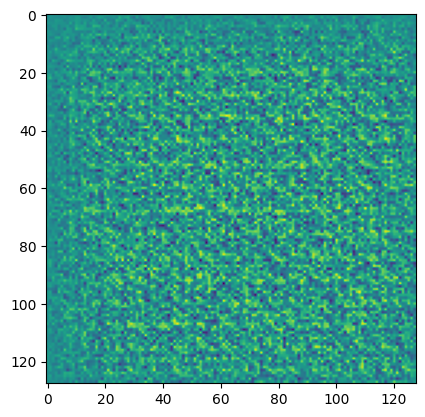

In [ ]:
noise = np.random.normal(-1,1,(1,100))
img = generator(noise)
plt.imshow(img[0,:,:,0])
plt.show()

In [ ]:
optimizer = tf.keras.optimizers.legacy.RMSprop(
        lr=.0001,
        clipvalue=1.0,
        decay=1e-8
    )
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits = False)

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/legacy/rmsprop.py:144: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [ ]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output),fake_output)
def discriminator_loss(fake_output, real_output):
    fake_loss = cross_entropy(tf.zeros_like(fake_output),fake_output)
    real_loss = cross_entropy(tf.ones_like(real_output),real_output)
    return fake_loss + real_loss

In [ ]:
def train_steps(images):
    noise = np.random.normal(0,1,(batch_size,latent_dim))
    with tf.GradientTape() as gen_tape , tf.GradientTape() as disc_tape:
        generated_images = generator(noise)
        fake_output = discriminator(generated_images)
        real_output = discriminator(images)

        gen_loss = generator_loss(fake_output)
        dis_loss = discriminator_loss(fake_output, real_output)


    gradient_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradient_of_discriminator = disc_tape.gradient(dis_loss, discriminator.trainable_variables)

    optimizer.apply_gradients(zip(gradient_of_generator,generator.trainable_variables))
    optimizer.apply_gradients(zip(gradient_of_discriminator, discriminator.trainable_variables))

    loss = {'gen loss':gen_loss,
           'disc loss': dis_loss}
    return loss

In [ ]:
def plot_generated_images(square = 5, epochs = 0):


  plt.figure(figsize = (10,10))
  for i in range(square * square):
    if epochs != 0:
        if(i == square //2):
            plt.title("Generated Image at Epoch:{}\n".format(epochs), fontsize = 32, color = 'black')
    plt.subplot(square, square, i+1)
    noise = np.random.normal(0,1,(1,latent_dim))
    img = generator(noise)
    plt.imshow(np.clip((img[0,...]+1)/2, 0, 1))
    plt.xticks([])
    plt.yticks([])
    plt.grid()
    plt.savefig(f"images/epoch_{epochs}.png")

In [ ]:
import time
def train(epochs,dataset):

    for epoch in range(epochs):
        start = time.time()
        print("\nEpoch : {}".format(epoch + 1))
        for images in tqdm(dataset, desc=f"Epoch {epoch+1}"):
            loss = train_steps(images)
        print(" Time:{}".format(np.round(time.time() - start),2))
        print("Generator Loss: {} Discriminator Loss: {}".format(loss['gen loss'],loss['disc loss']))
        plot_generated_images(3, epoch+1)






Epoch : 1


Epoch 1: 100%|██████████| 157/157 [05:15<00:00,  2.01s/it]


 Time:316.0
Generator Loss: 0.773548424243927 Discriminator Loss: 0.9132601022720337

Epoch : 2


Epoch 2: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 0.9556490182876587 Discriminator Loss: 0.6767808198928833

Epoch : 3


Epoch 3: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 1.0136313438415527 Discriminator Loss: 1.0957715511322021

Epoch : 4


Epoch 4: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 0.671338677406311 Discriminator Loss: 1.2706749439239502

Epoch : 5


Epoch 5: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 1.1013576984405518 Discriminator Loss: 1.2650562524795532

Epoch : 6


Epoch 6: 100%|██████████| 157/157 [05:13<00:00,  2.00s/it]


 Time:314.0
Generator Loss: 1.5423985719680786 Discriminator Loss: 1.3663393259048462

Epoch : 7


Epoch 7: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 0.41995370388031006 Discriminator Loss: 1.5961641073226929

Epoch : 8


Epoch 8: 100%|██████████| 157/157 [05:14<00:00,  2.00s/it]


 Time:315.0
Generator Loss: 0.705490231513977 Discriminator Loss: 1.071165680885315

Epoch : 9


Epoch 9: 100%|██████████| 157/157 [05:14<00:00,  2.00s/it]


 Time:315.0
Generator Loss: 1.7713286876678467 Discriminator Loss: 1.1702852249145508

Epoch : 10


Epoch 10: 100%|██████████| 157/157 [05:14<00:00,  2.00s/it]


 Time:314.0
Generator Loss: 0.9932061433792114 Discriminator Loss: 1.1667300462722778

Epoch : 11


Epoch 11: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 0.8401747941970825 Discriminator Loss: 0.9594777822494507

Epoch : 12


Epoch 12: 100%|██████████| 157/157 [05:14<00:00,  2.01s/it]


 Time:315.0
Generator Loss: 0.72216796875 Discriminator Loss: 0.9974174499511719

Epoch : 13


Epoch 13: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 0.41801780462265015 Discriminator Loss: 1.313355565071106

Epoch : 14


Epoch 14: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 1.3326077461242676 Discriminator Loss: 1.068892478942871

Epoch : 15


Epoch 15: 100%|██████████| 157/157 [05:14<00:00,  2.01s/it]


 Time:315.0
Generator Loss: 0.9466277360916138 Discriminator Loss: 0.8649650812149048

Epoch : 16


Epoch 16: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 1.081470251083374 Discriminator Loss: 0.772781491279602

Epoch : 17


Epoch 17: 100%|██████████| 157/157 [05:14<00:00,  2.00s/it]


 Time:315.0
Generator Loss: 0.5384589433670044 Discriminator Loss: 1.0920803546905518

Epoch : 18


Epoch 18: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 0.40844810009002686 Discriminator Loss: 1.353588342666626

Epoch : 19


Epoch 19: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 0.709536075592041 Discriminator Loss: 0.9406449794769287

Epoch : 20


Epoch 20: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 1.3157144784927368 Discriminator Loss: 0.7735508680343628

Epoch : 21


Epoch 21: 100%|██████████| 157/157 [05:11<00:00,  1.98s/it]


 Time:311.0
Generator Loss: 0.7180795073509216 Discriminator Loss: 0.94281005859375


<ipython-input-30-8ec45c734ae0>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (10,10))



Epoch : 22


Epoch 22: 100%|██████████| 157/157 [05:14<00:00,  2.00s/it]


 Time:314.0
Generator Loss: 0.6132923364639282 Discriminator Loss: 0.9500197172164917

Epoch : 23


Epoch 23: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 1.2886296510696411 Discriminator Loss: 0.8824996948242188

Epoch : 24


Epoch 24: 100%|██████████| 157/157 [05:14<00:00,  2.00s/it]


 Time:314.0
Generator Loss: 1.3382710218429565 Discriminator Loss: 0.5911842584609985

Epoch : 25


Epoch 25: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 1.0090138912200928 Discriminator Loss: 0.7184771299362183

Epoch : 26


Epoch 26: 100%|██████████| 157/157 [05:11<00:00,  1.98s/it]


 Time:312.0
Generator Loss: 0.839435875415802 Discriminator Loss: 0.7037524580955505

Epoch : 27


Epoch 27: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 1.5488286018371582 Discriminator Loss: 0.46854299306869507

Epoch : 28


Epoch 28: 100%|██████████| 157/157 [05:14<00:00,  2.00s/it]


 Time:314.0
Generator Loss: 1.0835082530975342 Discriminator Loss: 0.552744448184967

Epoch : 29


Epoch 29: 100%|██████████| 157/157 [05:12<00:00,  1.99s/it]


 Time:313.0
Generator Loss: 2.1153786182403564 Discriminator Loss: 0.4853109121322632

Epoch : 30


Epoch 30: 100%|██████████| 157/157 [05:21<00:00,  2.05s/it]


 Time:322.0
Generator Loss: 0.7599223256111145 Discriminator Loss: 0.8830515146255493


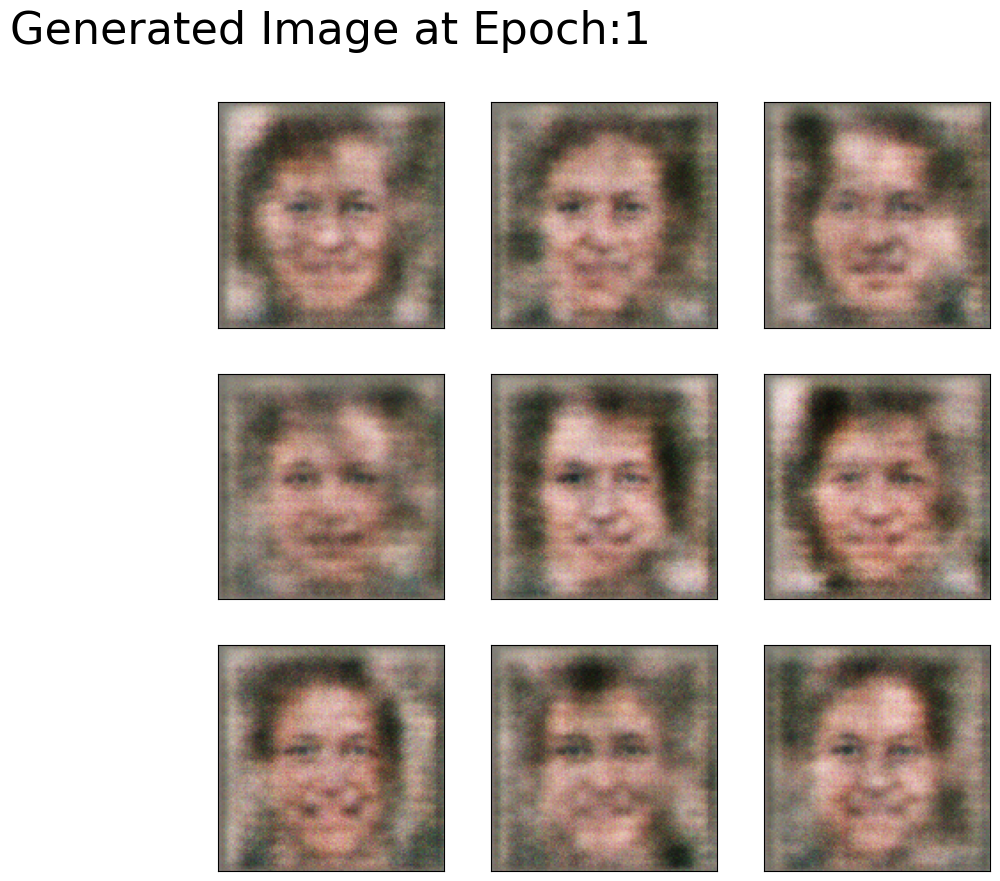

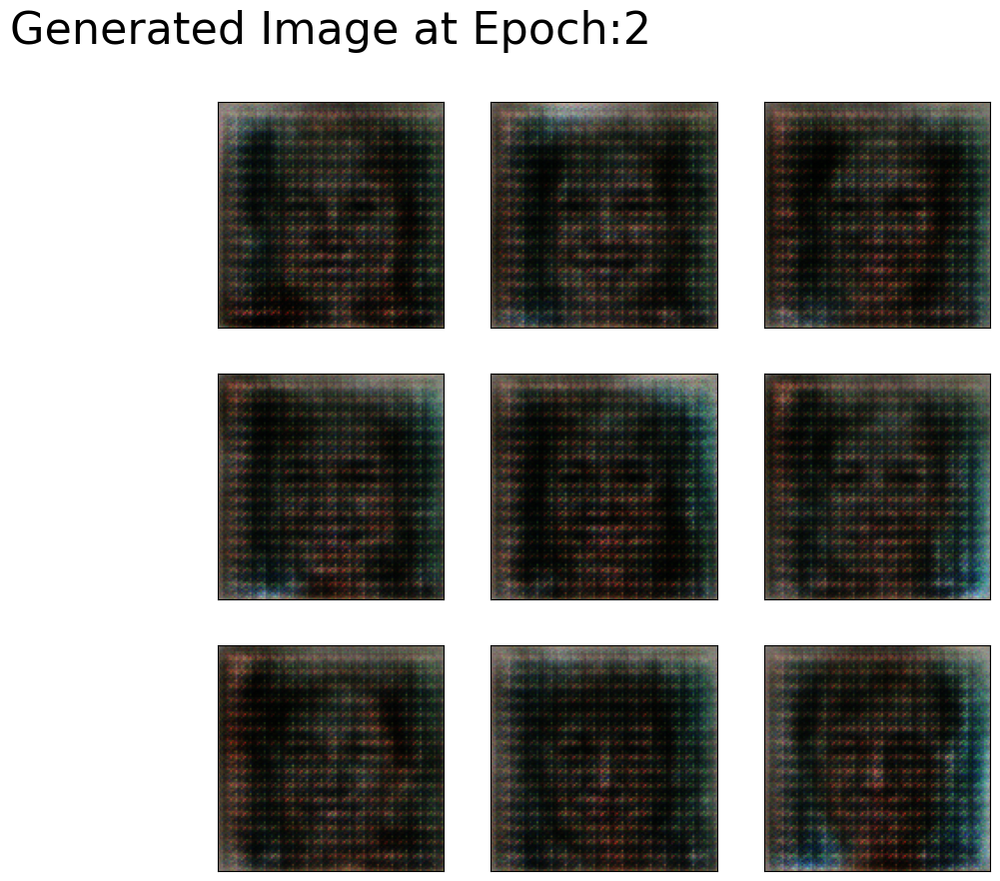

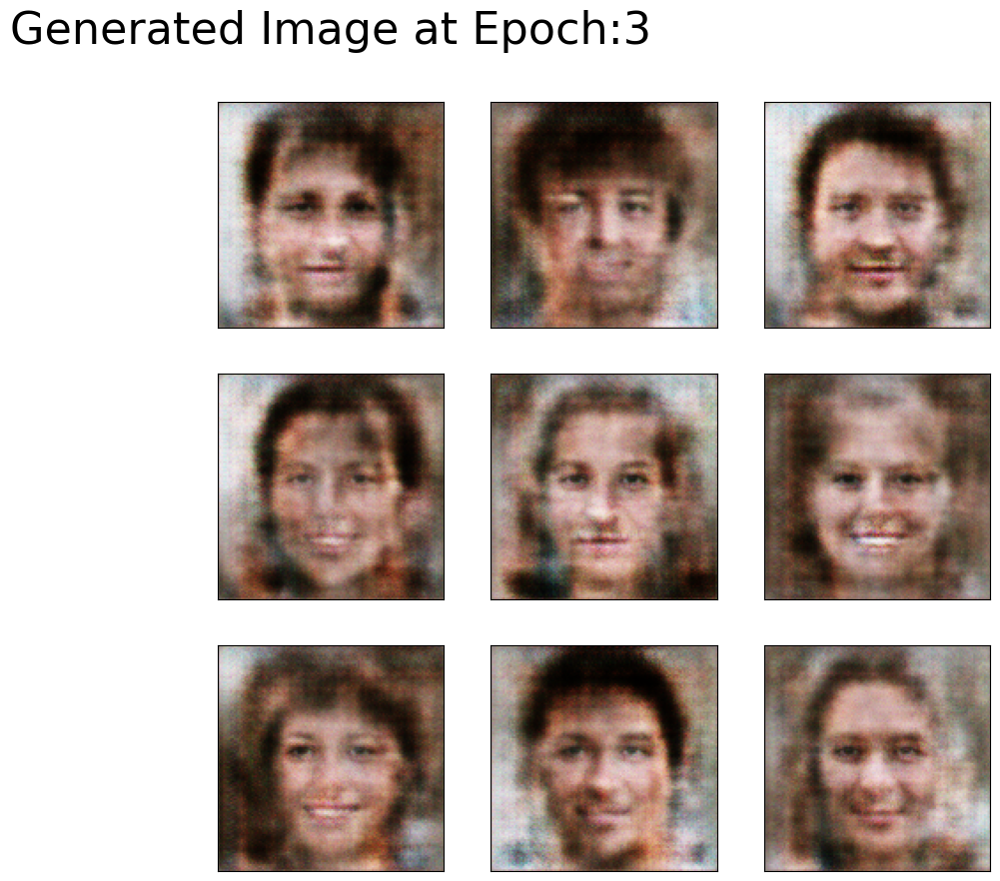

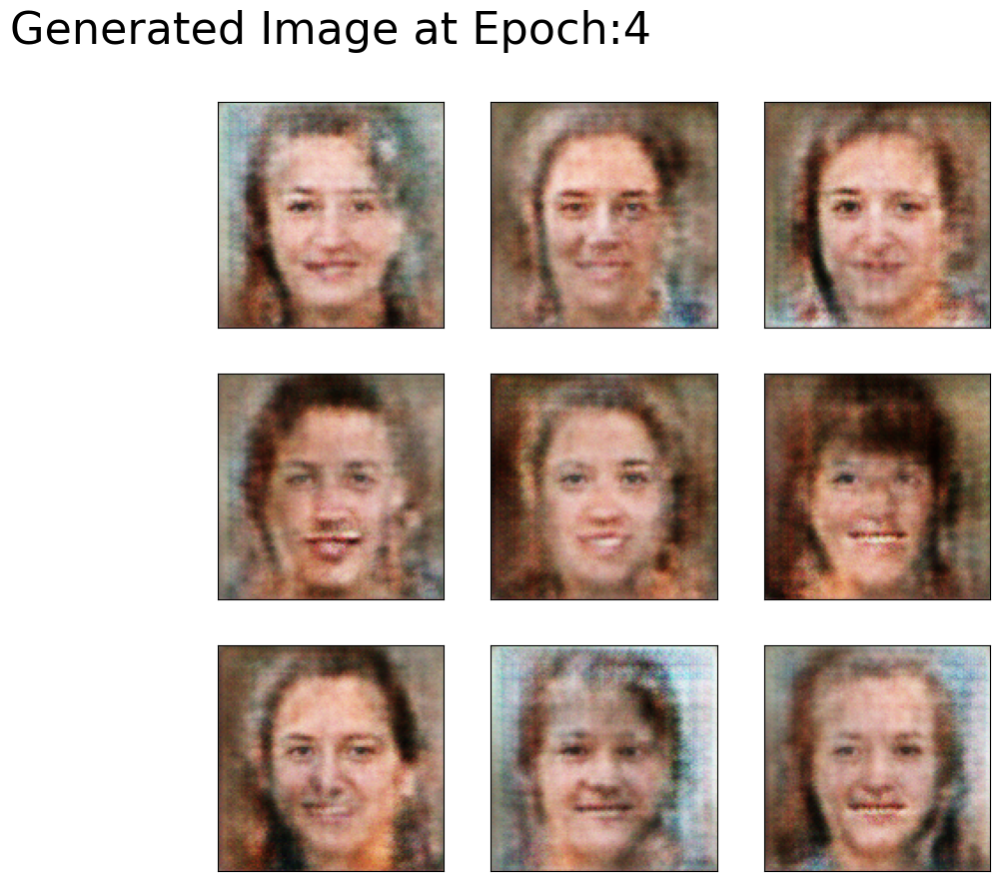

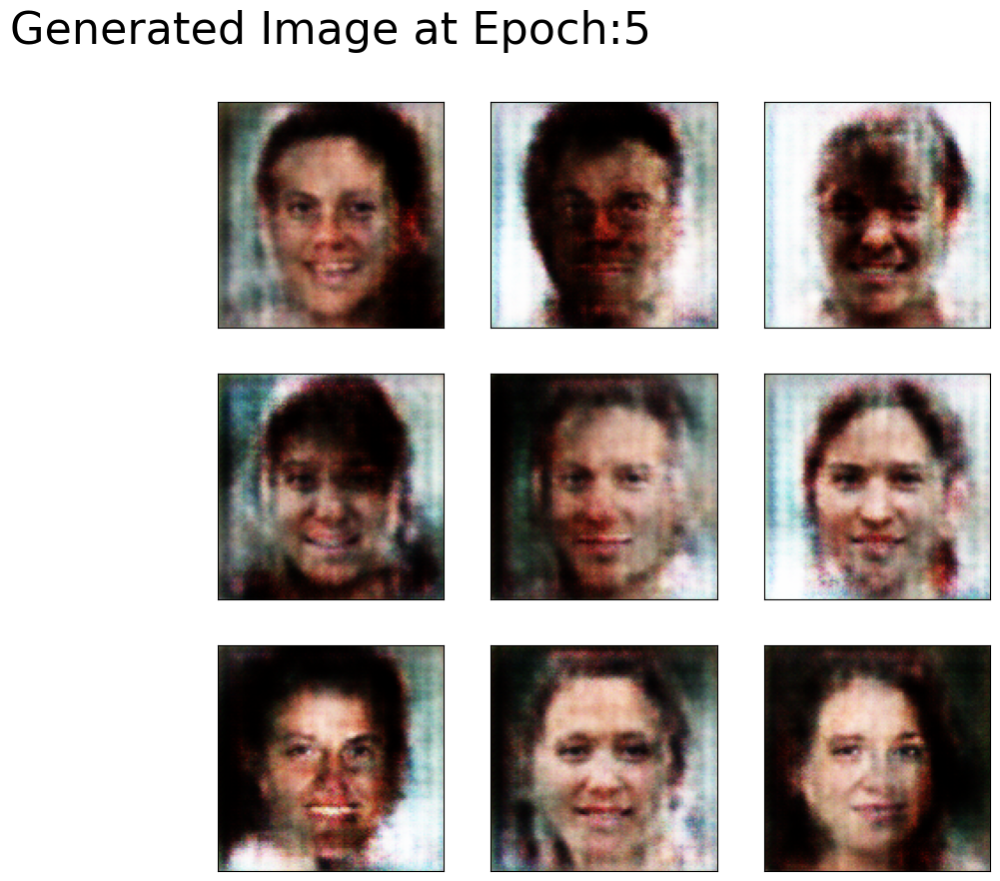

...

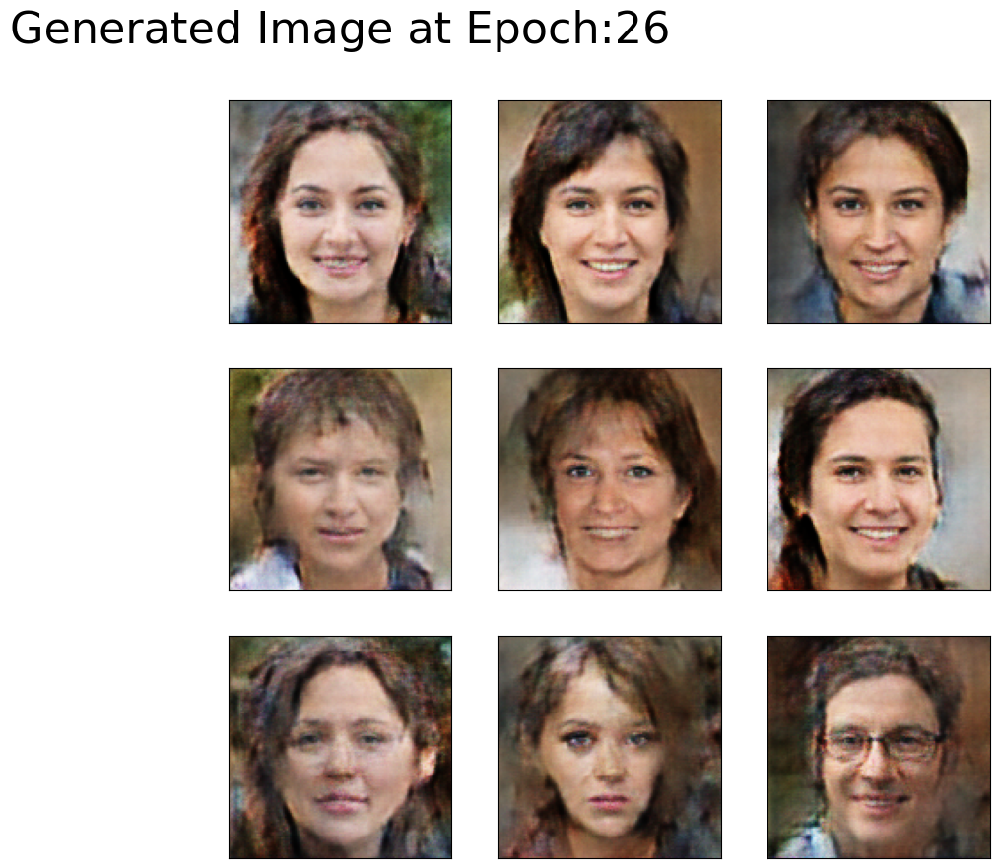

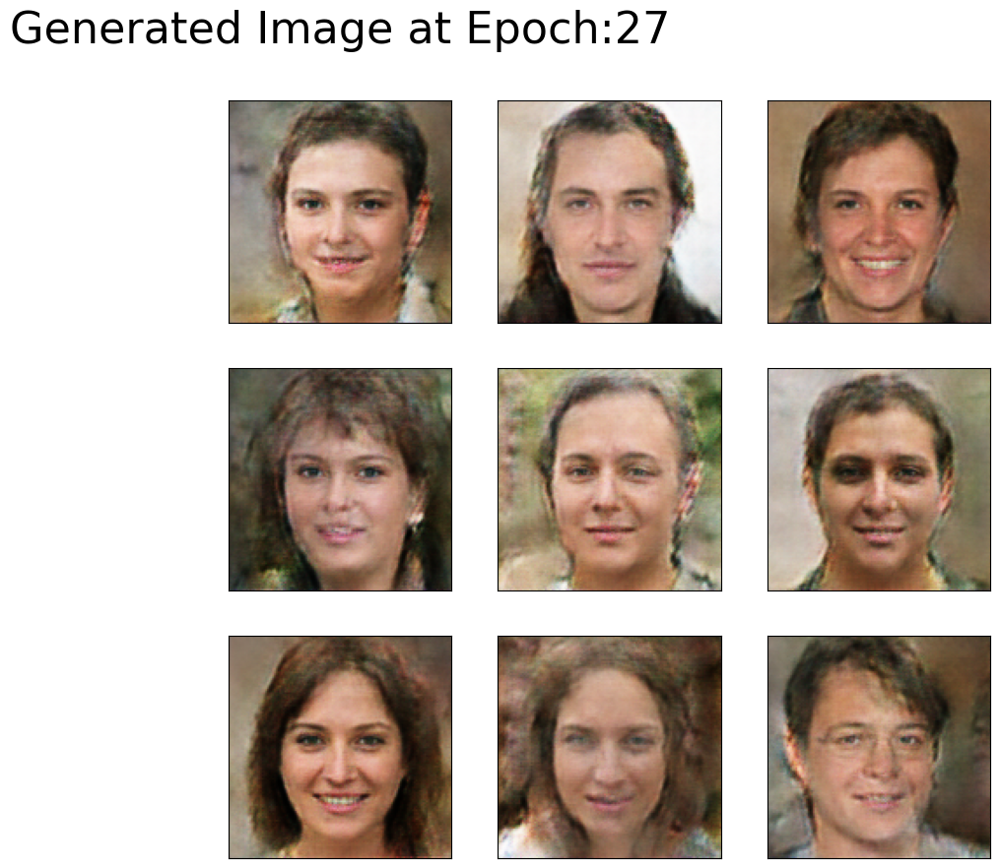

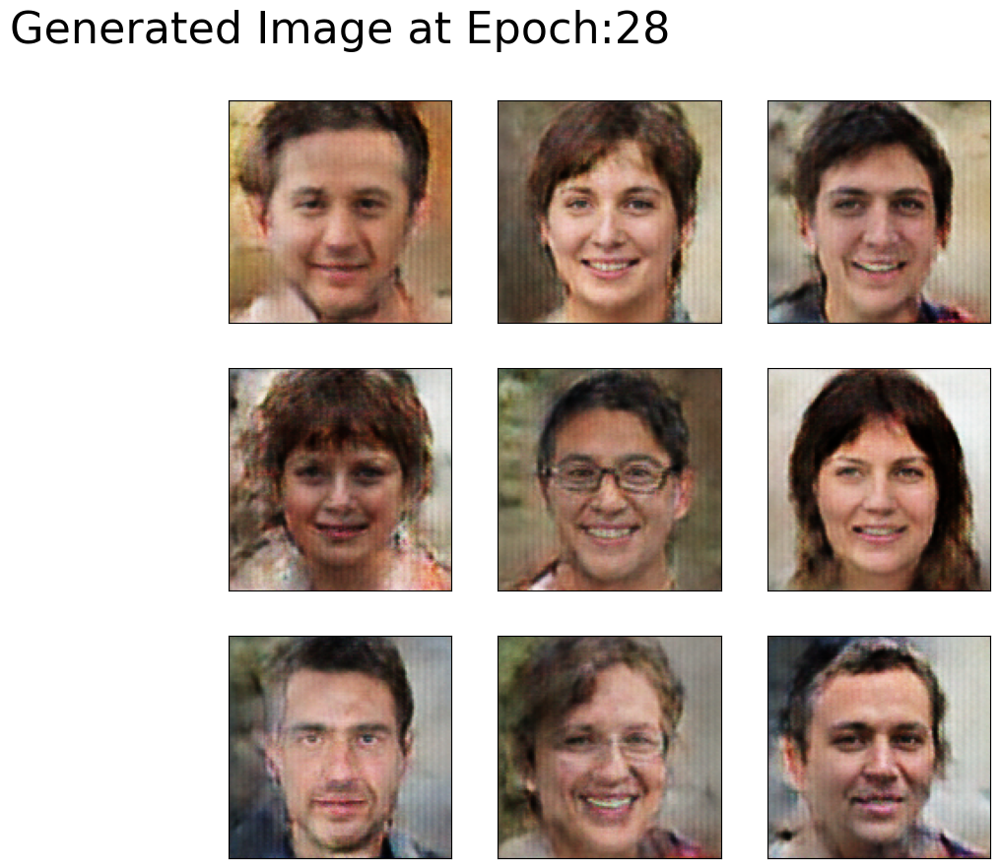

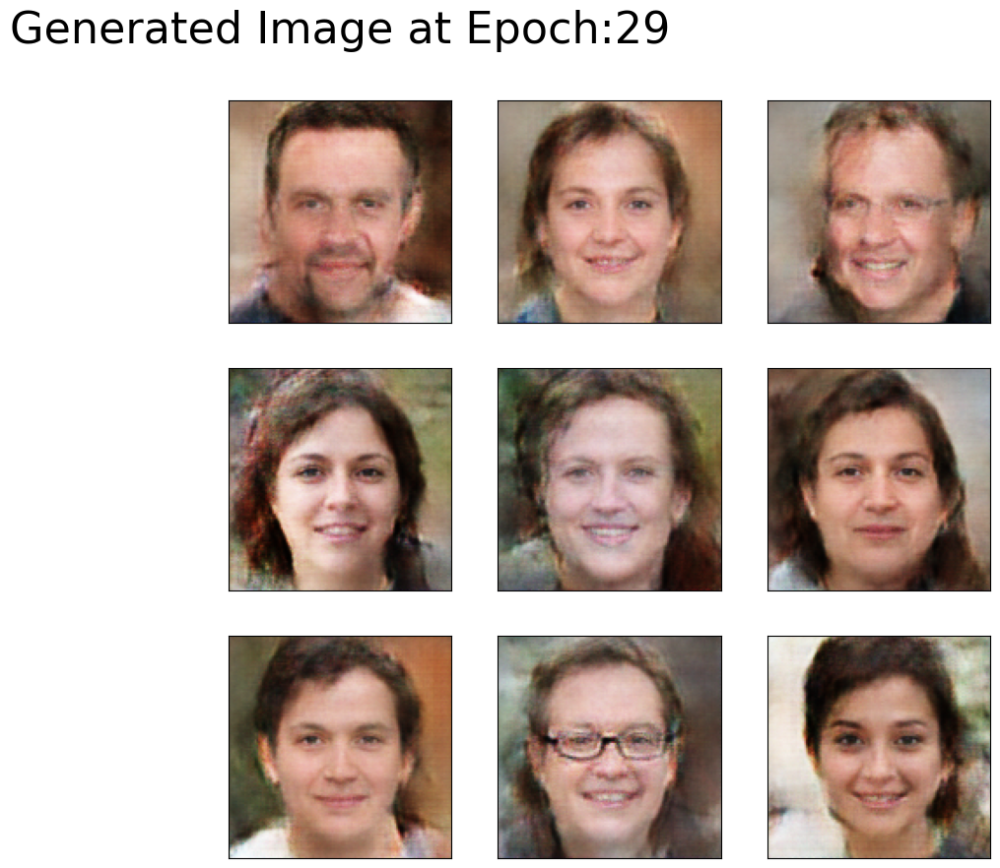

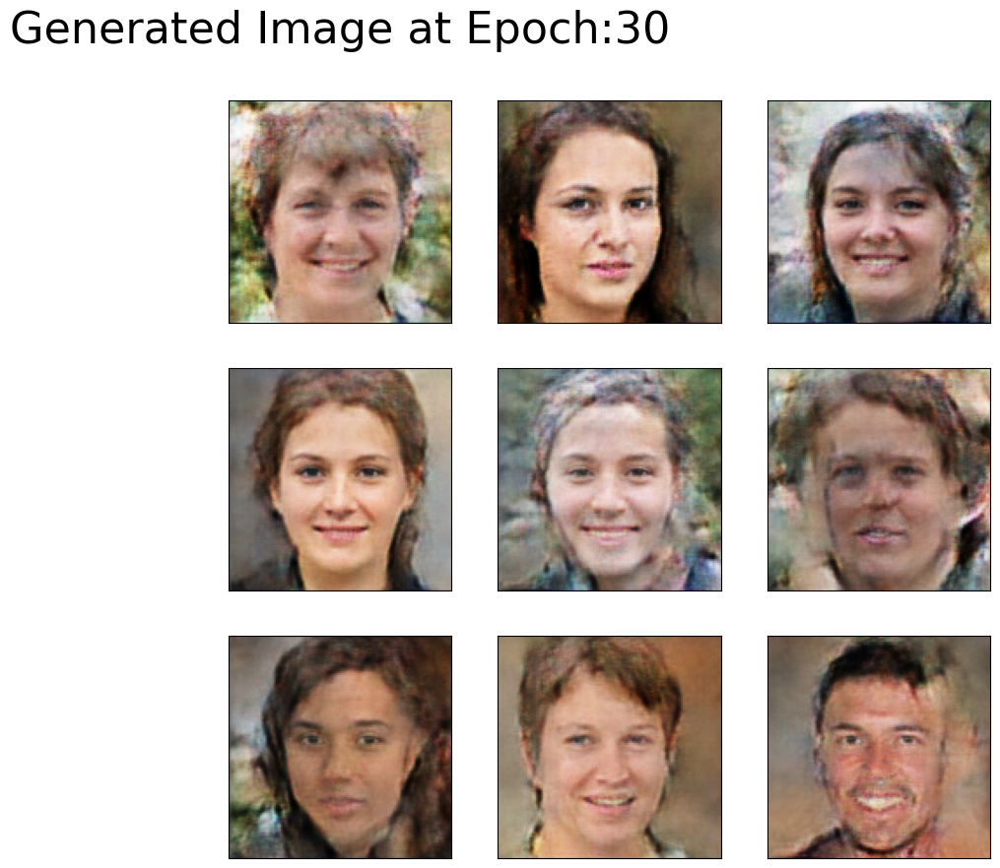

In [ ]:

train(30,dataset)

# Some Generated Images


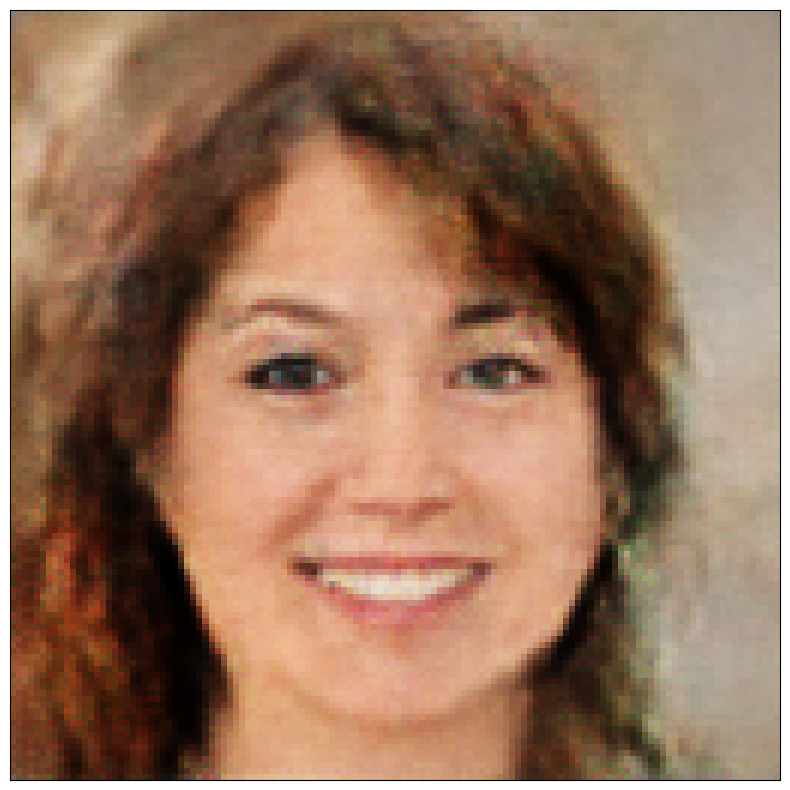

In [ ]:
plot_generated_images(1)

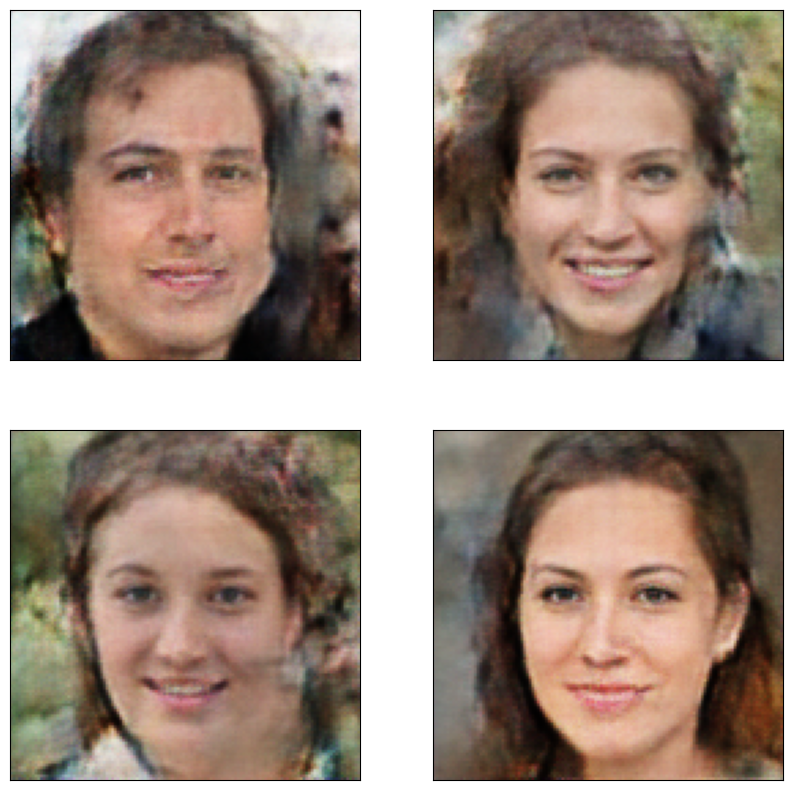

In [ ]:
plot_generated_images(2)

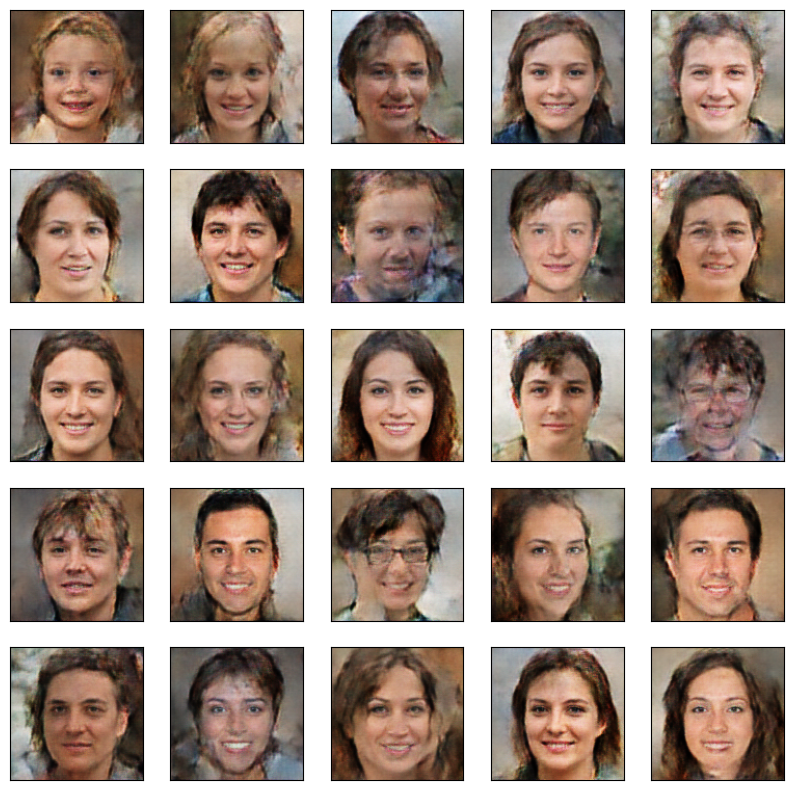

In [ ]:
plot_generated_images(5)

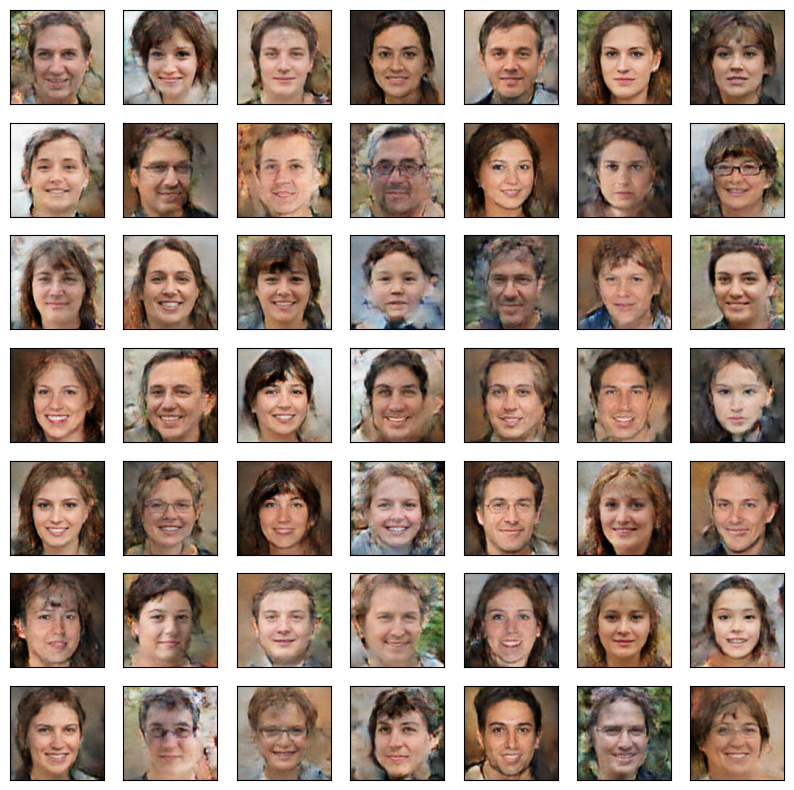

In [ ]:
plot_generated_images(7)

In [ ]:
generator.save('generator.h5')
discriminator.save("discriminator.h5")